# Imports

Repeating attempt to measure noise on UFM using RFSoC!

## shawnhammer startup

Started up by running `rfsochammer` in a terminal. Running on slot 3, rogue version /home/cryo/docker/smurf/stable/v8.0.0-rc3_rfsoc, and experiment.cfg cfg_files/b33/experiment_b33_rfc1-2_C05-40_s4_lbOnlyBay0_fiber
.cfg. `pysmurf` docker  /home/cryo/docker/pysmurf/dev/v8.0.0-rc3_rfsoc, tag v8.0.0-rc3 but with zcu208-devel merged into it.  `setup()`.  DR MXC is being servo'd to 100mK.

Locked to external timing system via fiber.

Rogue server configured to use PCIe card.  Running PCIe card software driver version 5.19.3, PCIe card firmware version d89c87b6b29ddc5dab8a3be374e749725d598399.

## Load, check, and record configuration

RFSoC

In [107]:
import matplotlib
matplotlib.use('Agg')
%matplotlib inline
import matplotlib.pyplot as plt
import yaml
import time
import pickle as pkl
import os
import numpy as np
from matplotlib import cm
from scipy.signal import welch,periodogram
import pandas as pd
import glob
from scipy.optimize import curve_fit
from scipy import signal

import pysmurf.client
import matplotlib.pylab as plt
import numpy as np
import sys
import os
epics_prefix="smurf_server_s3"
config_file=os.path.abspath("/usr/local/src/pysmurf/cfg_files/b33/experiment_b33_rfc1-2_C05-40_s4_lbOnlyBay0_fiber.cfg")
S = pysmurf.client.SmurfControl(epics_root=epics_prefix,cfg_file=config_file,setup=False,make_logfile=False,shelf_manager="shm-smrf-sp01")

[ 2024-08-09 00:23:05 ]  ERROR : band 0 is present in pysmurf cfg file, but its bay is not enabled!
[ 2024-08-09 00:23:05 ]  ERROR : band 1 is present in pysmurf cfg file, but its bay is not enabled!
[ 2024-08-09 00:23:05 ]  ERROR : band 2 is present in pysmurf cfg file, but its bay is not enabled!
[ 2024-08-09 00:23:05 ]  ERROR : band 3 is present in pysmurf cfg file, but its bay is not enabled!


AMC SMuRF

In [108]:
epics_prefix="smurf_server_s4"
config_file=os.path.abspath("/usr/local/src/pysmurf/cfg_files/b33/experiment_b33_rfc1-2_C05-40_s4_lbOnlyBay0_backplane.cfg")
Samc = pysmurf.client.SmurfControl(epics_root=epics_prefix,cfg_file=config_file,setup=False,make_logfile=False,shelf_manager="shm-smrf-sp01")

In [109]:
S.setup()

[ 2024-08-09 00:23:10 ]  System already configured once while this Rogue server has been up.
[ 2024-08-09 00:23:10 ]  If you really want to configure again, run setup with force_configure=True.


False

Is timing up?

In [110]:
S.get_timing_link_up()

1

What versions of everything are we running?

In [111]:
pysmurf.__version__

'8.0.0-rc3+12.gc1067044'

In [112]:
!git branch

* (HEAD detached from v8.0.0-rc3)
  zcu208-devel


In [113]:
S._caget(f'{epics_prefix}:AMCc:RogueVersion', as_string=True)

'v4.11.11'

In [114]:
S._caget(f'{epics_prefix}:AMCc:SmurfApplication:SmurfVersion', as_string=True)

'8.0.0-rc3'

In [115]:
S._caget(f'{epics_prefix}:AMCc:SmurfApplication:StartupArguments', as_string=True)

'-w smurf_server_s4 -e smurf_server_s4 -l 2 -a 10.0.1.104 -z /tmp/fw/rogue_MicrowaveMuxBpEthGen2_v1.1.1.zip --disable-bay1 -d /tmp/fw/smurf_cfg/defaults/defaults_c03_lb_none.yml --enable-em22xx'

In [116]:
S.get_fpga_git_hash_short()

'e54bbcc'

Check timing configuration

In [117]:
print(S.get_timing_mode())

fiber


In [118]:
S.set_downsample_mode('external')
S.set_downsample_factor(20)

Chao reports unable to get flux ramping to work on band 3.

In [221]:
for band in S._bands:
    print(f'b{band} : {len(S.which_on(band))}')

b0 : 46
b1 : 0
b2 : 0
b3 : 0


Let's kill the channels in band 2.

In [293]:
band=3
for chan in S.which_on(band):
    S.channel_off(band,chan)

[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 11
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 15
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 19
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 28
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 35
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 43
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 44
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 56
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 60
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 63
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 76
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 79
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 80
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 83
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 96
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 107
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 111
[ 2024-08-09 17:59:39 ]  Turning off band 3 channel 120
[ 2024-

Let's turn off the flux ramp and make sure the band 3 resonators are locked.

[ 2024-08-09 18:00:40 ]  Sweeping across frequencies 5500.0MHz to 6000.0MHz
[ 2024-08-09 18:00:40 ]  Working on band 3
[ 2024-08-09 18:01:11 ]  serial find freq complete ; etaScanInProgress = 0


/usr/local/src/pysmurf/python/pysmurf/client/tune/smurf_tune.py:906: RuntimeWarning: invalid value encountered in scalar divide
  if 1-amp[idx]/med_amp[idx] > amp_cut:


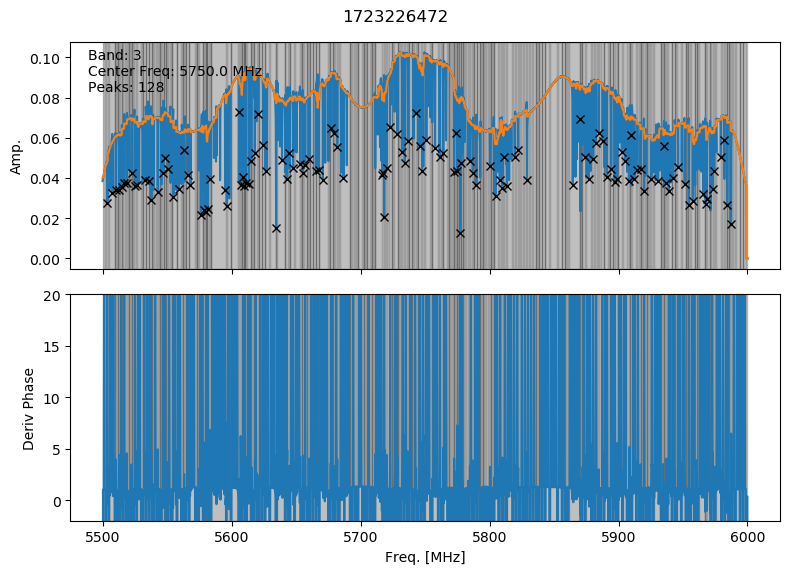

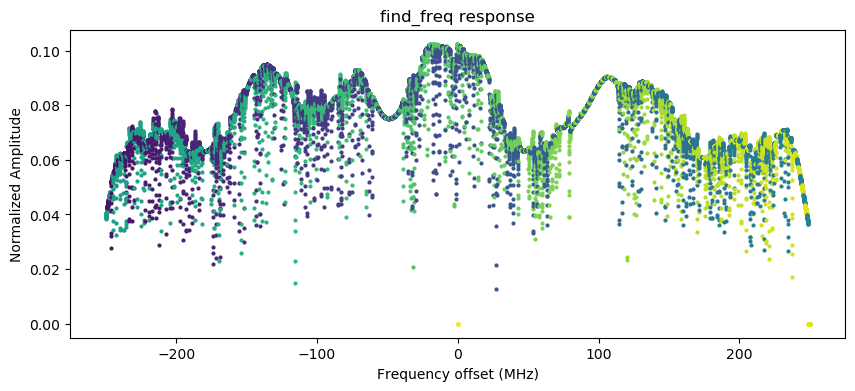

In [295]:
band=3
bands=[3]
freqs, resps = S.find_freq(band=band, start_freq=-250, stop_freq=250, tone_power=12,grad_cut=0.01, amp_cut=0.1,make_plot=True,show_plot=True)

[ 2024-08-09 18:01:17 ]  No tone_power given. Using value in config file: 12
[ 2024-08-09 18:01:17 ]  freq 5503.5600 - 1 of 128
[ 2024-08-09 18:01:17 ]  freq 5507.4800 - 2 of 128
[ 2024-08-09 18:01:17 ]  freq 5510.0400 - 3 of 128
[ 2024-08-09 18:01:17 ]  freq 5512.6000 - 4 of 128
[ 2024-08-09 18:01:17 ]  freq 5514.5600 - 5 of 128
[ 2024-08-09 18:01:17 ]  freq 5516.4400 - 6 of 128
[ 2024-08-09 18:01:17 ]  freq 5518.5200 - 7 of 128
[ 2024-08-09 18:01:17 ]  freq 5522.3200 - 8 of 128
[ 2024-08-09 18:01:17 ]  freq 5524.7600 - 9 of 128
[ 2024-08-09 18:01:17 ]  freq 5526.8000 - 10 of 128
[ 2024-08-09 18:01:17 ]  freq 5533.0800 - 11 of 128
[ 2024-08-09 18:01:17 ]  freq 5535.4800 - 12 of 128
[ 2024-08-09 18:01:17 ]  freq 5537.5200 - 13 of 128
[ 2024-08-09 18:01:17 ]  freq 5542.6400 - 14 of 128
[ 2024-08-09 18:01:17 ]  freq 5546.9600 - 15 of 128
[ 2024-08-09 18:01:17 ]  freq 5548.5200 - 16 of 128
[ 2024-08-09 18:01:17 ]  freq 5550.6800 - 17 of 128
[ 2024-08-09 18:01:17 ]  freq 5554.8000 - 18 of 

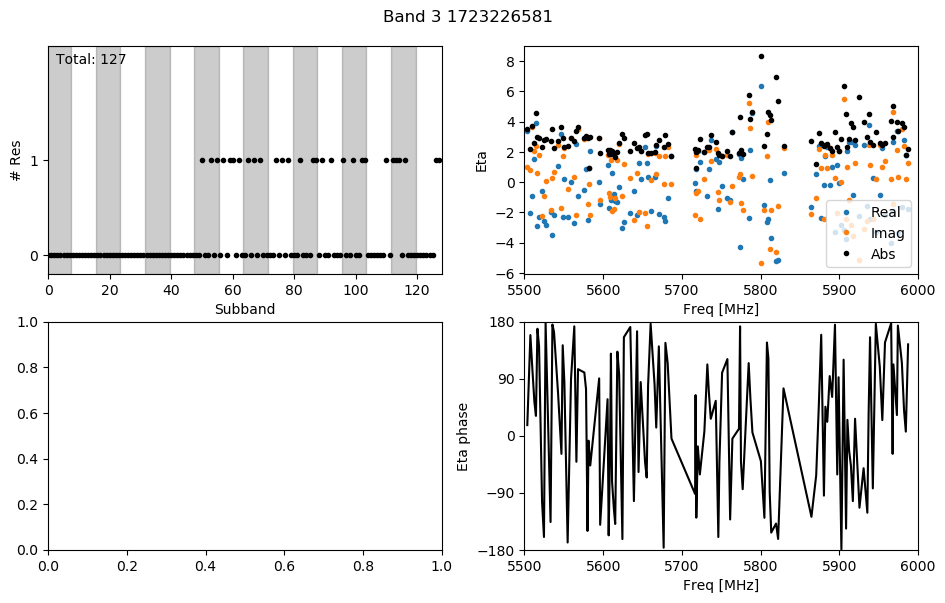

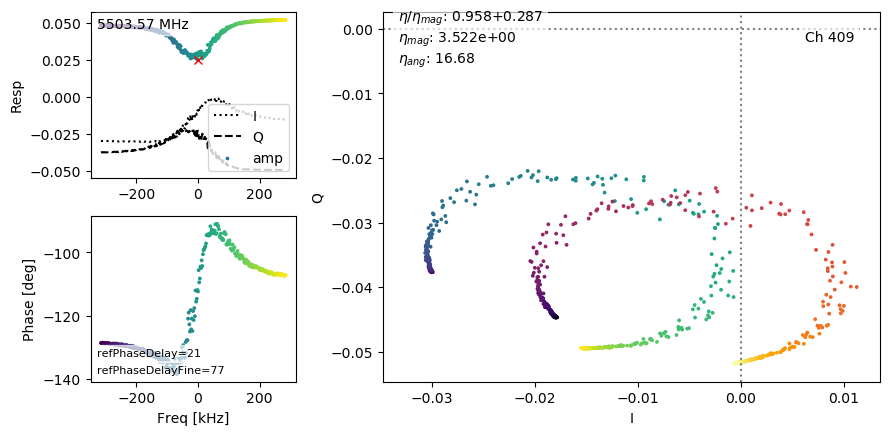

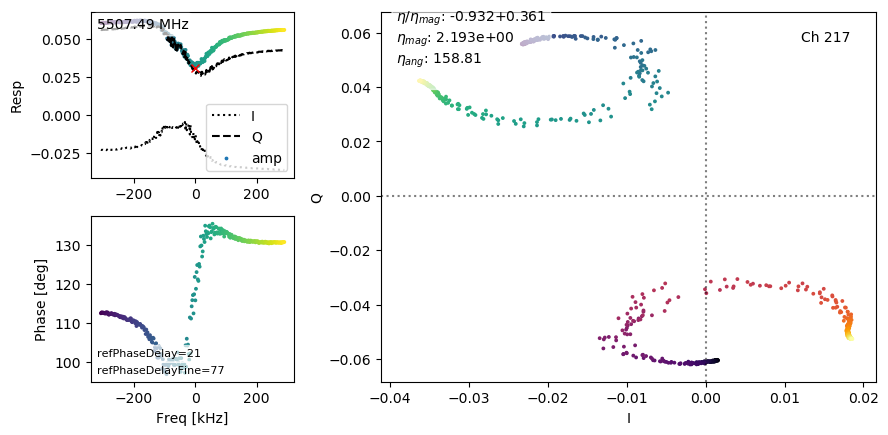

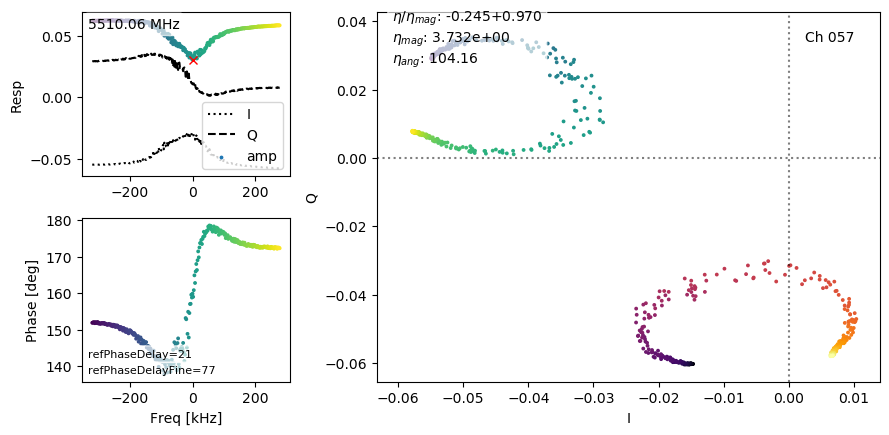

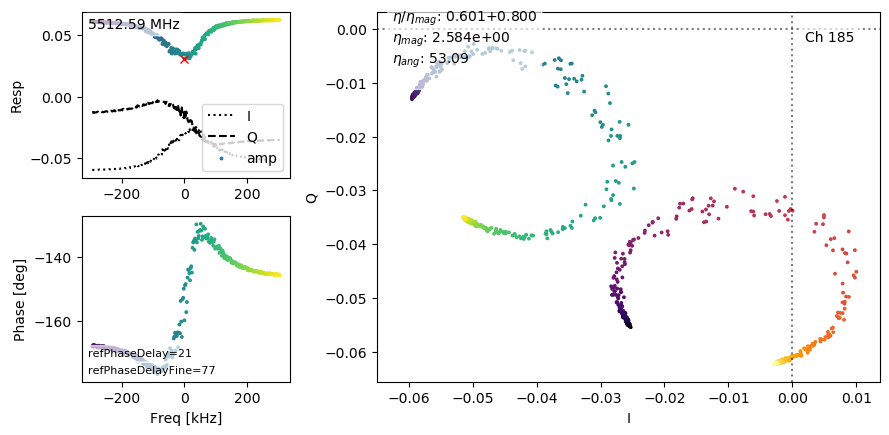

...

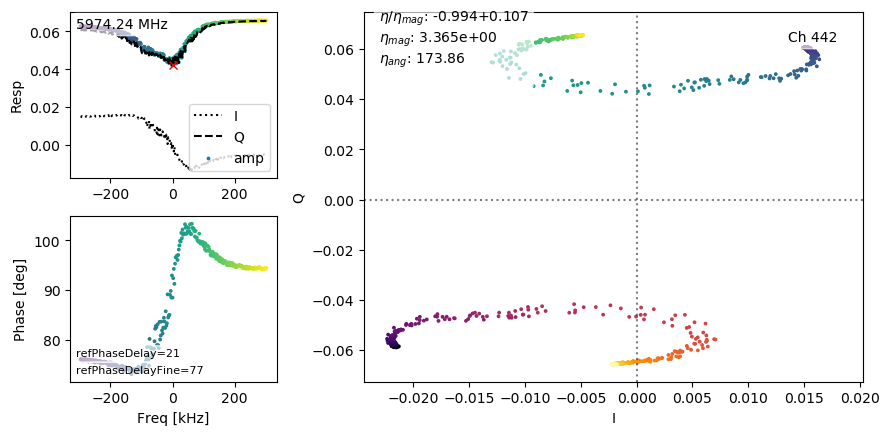

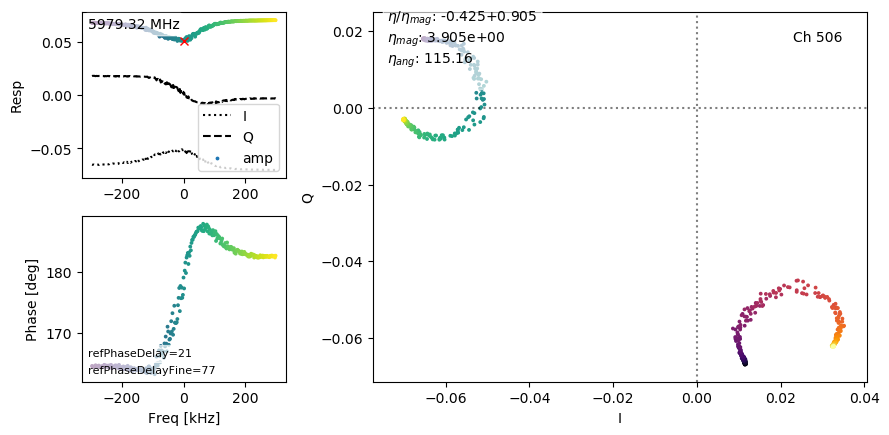

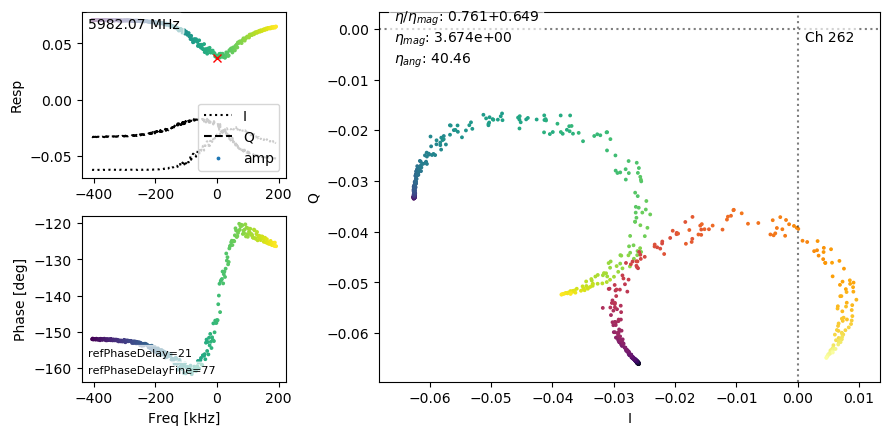

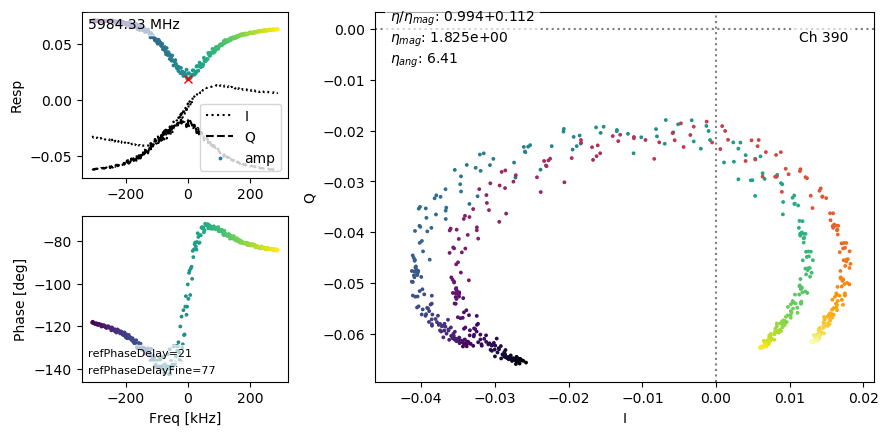

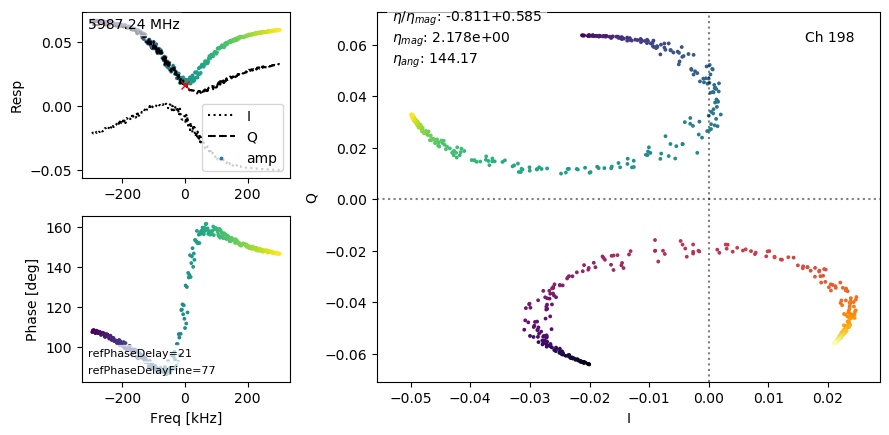

In [296]:
for band in bands:
    # Tune
    S.setup_notches(band,new_master_assignment=True)
    
    # Refine tuning
    S.run_serial_gradient_descent(band)
    
    # Refine eta calibrations
    S.run_serial_eta_scan(band)
    S.plot_tune_summary(band,eta_scan=True,show_plot=True)

In [297]:

for band in bands:
    for chan in S.which_on(band):
        print(f'band={band} chan={chan} : {S.channel_to_freq(band,chan)}')

band=3 chan=3 : 5596.111703300476
band=3 chan=10 : 5942.440213441849
band=3 chan=11 : 5634.396012401581
band=3 chan=19 : 5615.215968036652
band=3 chan=24 : 5807.936001110077
band=3 chan=28 : 5884.563839769363
band=3 chan=35 : 5605.522295284271
band=3 chan=42 : 5951.264166688919
band=3 chan=43 : 5644.842012310028
band=3 chan=45 : 5568.011900186539
band=3 chan=53 : 5548.538235616684
band=3 chan=57 : 5510.059875488281
band=3 chan=60 : 5894.356002807617
band=3 chan=66 : 5908.4601515769955
band=3 chan=69 : 5524.739941596985
band=3 chan=74 : 5946.257877492905
band=3 chan=76 : 5870.501896810531
band=3 chan=77 : 5563.270045757294
band=3 chan=79 : 5716.69998755455
band=3 chan=80 : 5773.813870716095
band=3 chan=83 : 5620.221895313262
band=3 chan=90 : 5965.714052343368
band=3 chan=96 : 5764.06192407608
band=3 chan=99 : 5611.212025213242
band=3 chan=114 : 5937.073966503143
band=3 chan=120 : 5822.152020311356
band=3 chan=121 : 5514.552247142792
band=3 chan=124 : 5898.925893735885
band=3 chan=132 : 

In [298]:
Samc.flux_ramp_off()

S.set_band_delay_us(band,8.5)

# Fast re-estimate of each resonator's frequency
S.run_serial_gradient_descent(band)

# Fast re-estimate of resonator circle calibration
S.run_serial_eta_scan(band)

Before moving on to tracking, let's make sure neither the ADC or DAC are saturated;

In [299]:

S.check_dac_saturation(band)
S.check_adc_saturation(band)

[ 2024-08-09 18:06:36 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:AppTop:DaqMuxV2[0]:DataBufferSize 4096
[ 2024-08-09 18:06:36 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:AppTop:AppCore:DebugSelect[0] 3
[ 2024-08-09 18:06:36 ]  DAC3 max count: 12603
[ 2024-08-09 18:06:36 ]  DAC3 min count: -13270
[ 2024-08-09 18:06:36 ]  DAC3 not saturated
[ 2024-08-09 18:06:36 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:AppTop:DaqMuxV2[0]:DataBufferSize 4096
[ 2024-08-09 18:06:36 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:AppTop:AppCore:DebugSelect[0] 3
[ 2024-08-09 18:06:36 ]  ADC3 max count: 2648
[ 2024-08-09 18:06:36 ]  ADC3 min count: -2612
[ 2024-08-09 18:06:36 ]  ADC3 not saturated


False

Not clipping either the RF DAC or ADC.

## Tracking setup

Can we see modulation with feedback disabled?

[ 2024-08-09 00:11:44 ]  Using LMS gain is now an advanced feature.
[ 2024-08-09 00:11:44 ]  Unless you are an expert, you probably want feedback_gain.
[ 2024-08-09 00:11:44 ]  See tracking_setup docstring.
[ 2024-08-09 00:11:44 ]  Starting fraction full scale : 0.489
[ 2024-08-09 00:11:45 ]  Percent full scale = 48.900%
[ 2024-08-09 00:11:45 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:AppTop:AppCore:SysgenCryo:Base[2]:singleChannelReadout 0
[ 2024-08-09 00:11:45 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:AppTop:AppCore:SysgenCryo:Base[2]:singleChannelReadoutOpt2 0
[ 2024-08-09 00:11:45 ]  Writing to file : /data/smurf_data/20240808/1723154700/outputs/1723162305.dat
[ 2024-08-09 00:11:45 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:AppTop:DaqMuxV2[0]:DataBufferSize 524288
[ 2024-08-09 00:11:45 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:AppTop:AppCore:DebugSelect[0] 2
[ 2024-08-09 00:11:45 ]  Data acquisition in progress...
[ 2024-08-09 00:11:45 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:A

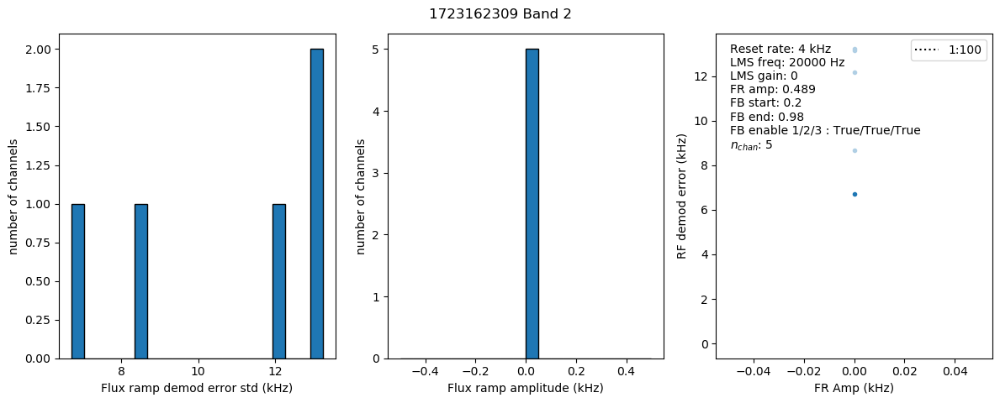

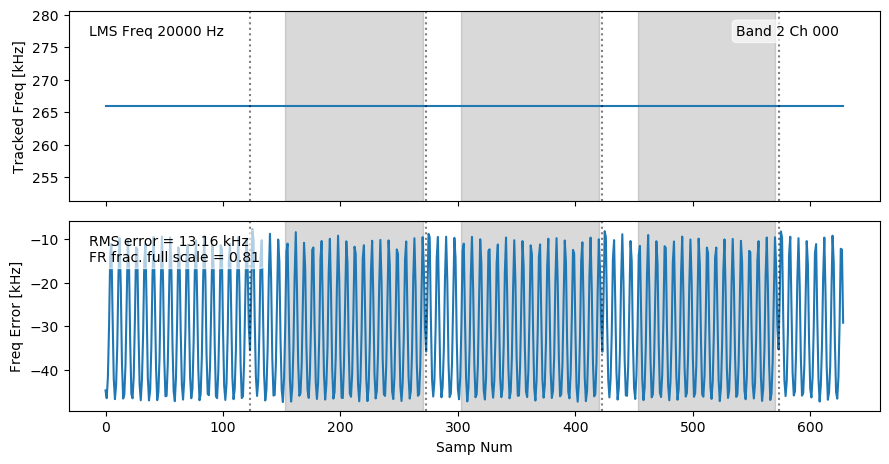

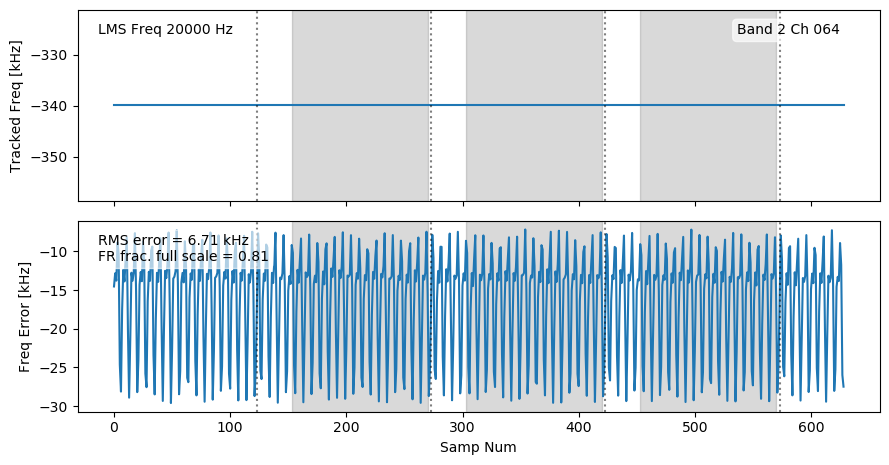

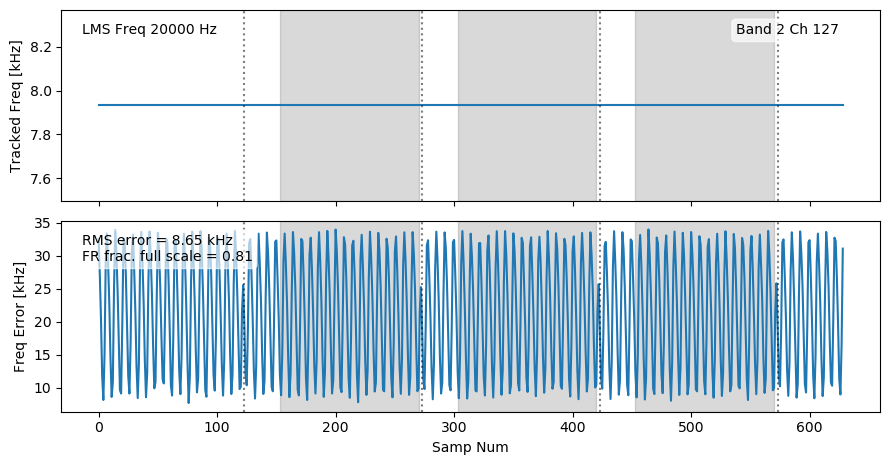

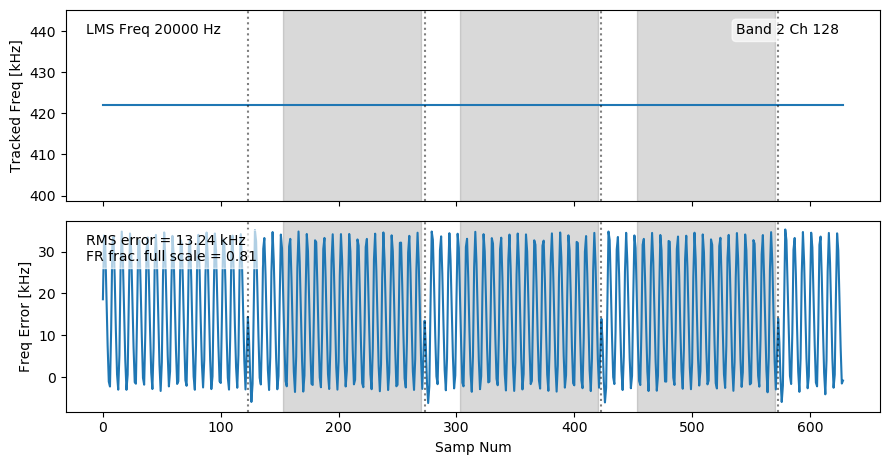

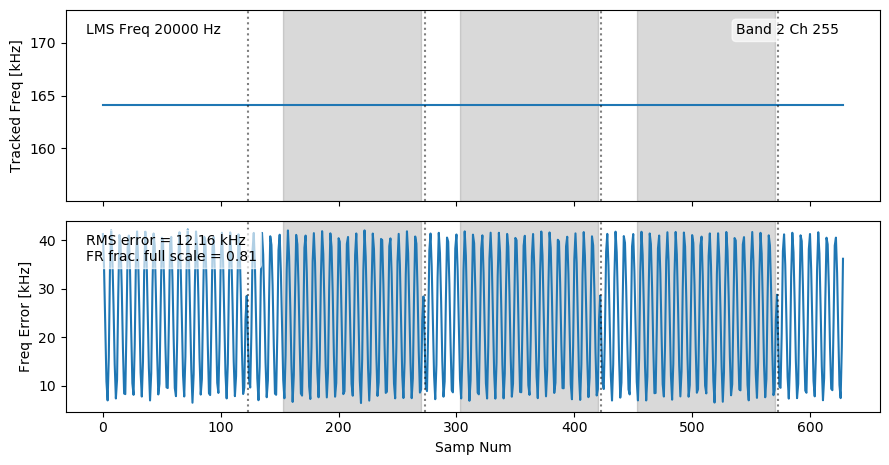

In [101]:
band=2
S.set_feedback_enable(band,0)
S.tracking_setup(band, channel = S.which_on(band), reset_rate_khz=4, make_plot=True, save_plot=True, show_plot=True, 
                  lms_freq_hz=None, n_phi0=5, meas_flux_ramp_amp=True, fraction_full_scale=0.2,feedback_gain=2048,lms_gain=0,
                  return_data=False, feedback_start_frac=0.2, feedback_end_frac=0.98,nsamp = 2**18, new_epics_root='smurf_server_s4')

That looks ok.  Let's see if it can track on them with feedback enabled.  Only plot 10 channels or else it will take forever.

In [184]:
S.toggle_feedback(2)

[ 2024-08-09 06:17:56 ]  Before toggling feedback on band 2, feedbackEnable=1, lmsEnable1=1, lmsEnable2=1, and lmsEnable3=1.
[ 2024-08-09 06:17:56 ]  Setting feedbackEnable=lmsEnable1=lmsEnable2=lmsEnable3=0 (in that order).
[ 2024-08-09 06:17:56 ]  Set feedbackEnable=lmsEnable1=lmsEnable2=lmsEnable3=1 (in that order).


[ 2024-08-09 18:06:36 ]  Using LMS gain is now an advanced feature.
[ 2024-08-09 18:06:36 ]  Unless you are an expert, you probably want feedback_gain.
[ 2024-08-09 18:06:36 ]  See tracking_setup docstring.
[ 2024-08-09 18:06:36 ]  Temporarily using new epics root: smurf_server_s4
[ 2024-08-09 18:06:36 ]  Returning back to original epics root : smurf_server_s3
[ 2024-08-09 18:06:36 ]  Temporarily using new epics root: smurf_server_s4
[ 2024-08-09 18:06:36 ]  Returning back to original epics root : smurf_server_s3
[ 2024-08-09 18:06:36 ]  Percent full scale = 19.500%
[ 2024-08-09 18:06:36 ]  Temporarily using new epics root: smurf_server_s4
[ 2024-08-09 18:06:36 ]  Returning back to original epics root : smurf_server_s3
[ 2024-08-09 18:06:36 ]  Temporarily using new epics root: smurf_server_s4
[ 2024-08-09 18:06:36 ]  Returning back to original epics root : smurf_server_s3
[ 2024-08-09 18:06:36 ]  Temporarily using new epics root: smurf_server_s4
[ 2024-08-09 18:06:36 ]  Returning back 

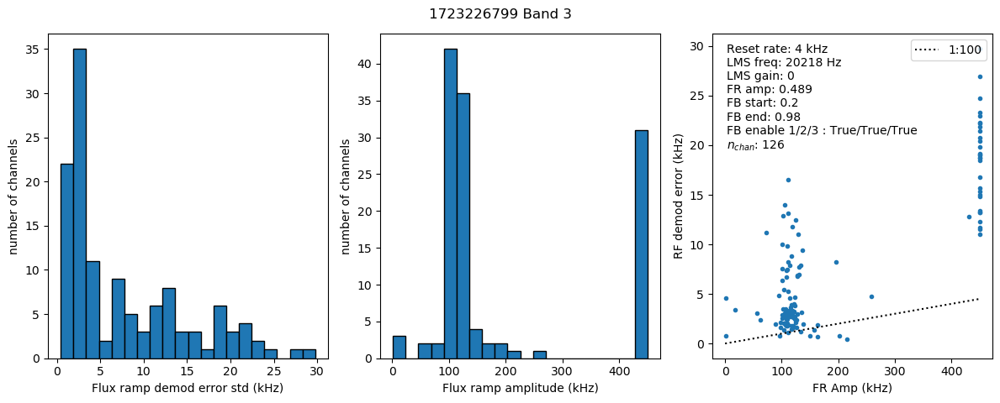

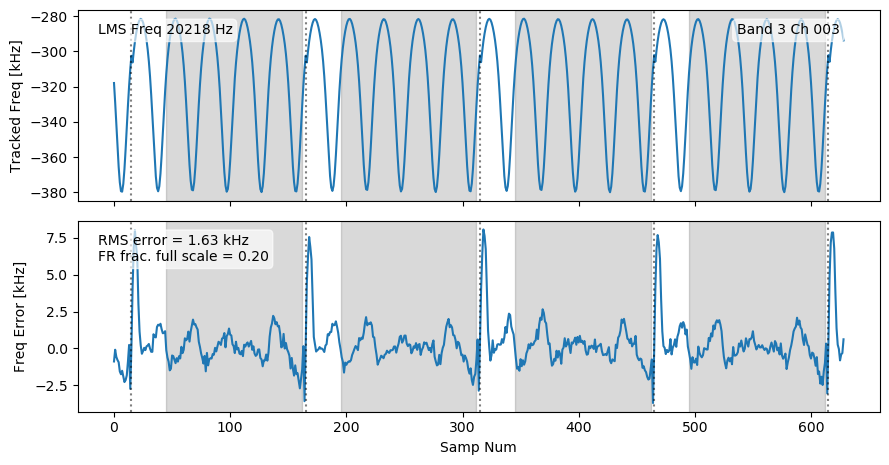

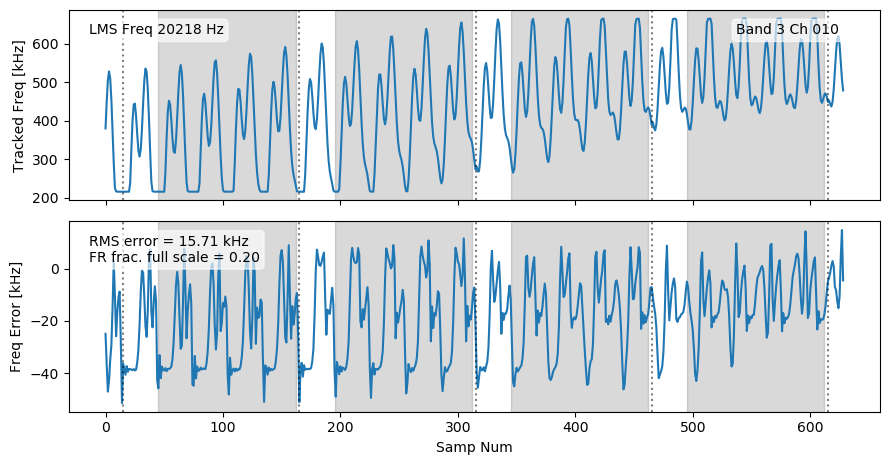

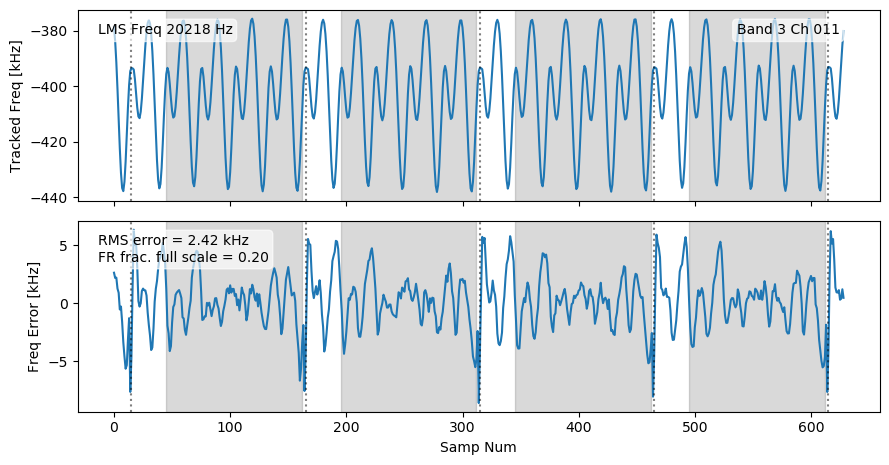

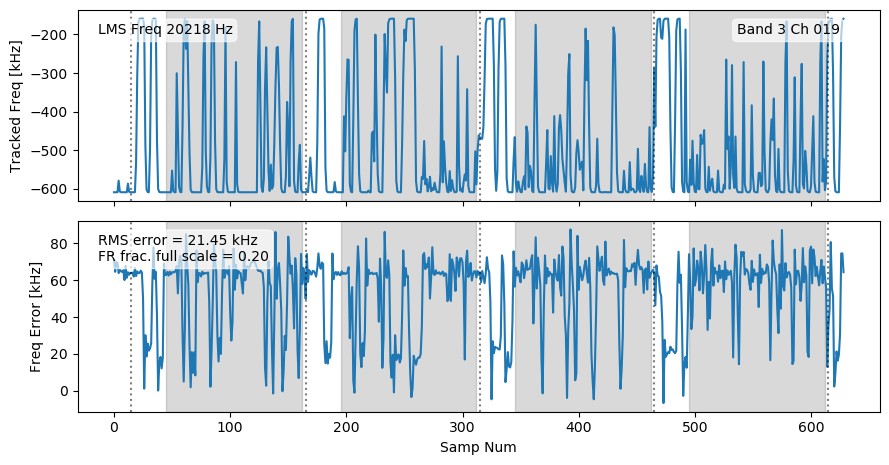

...

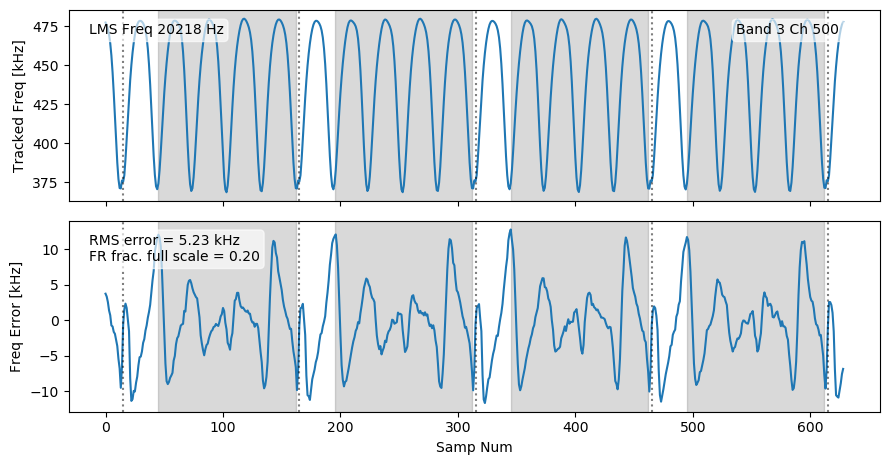

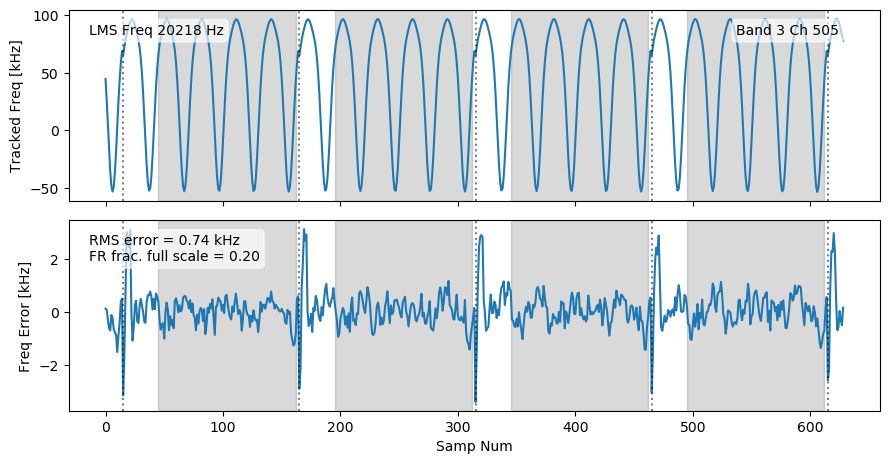

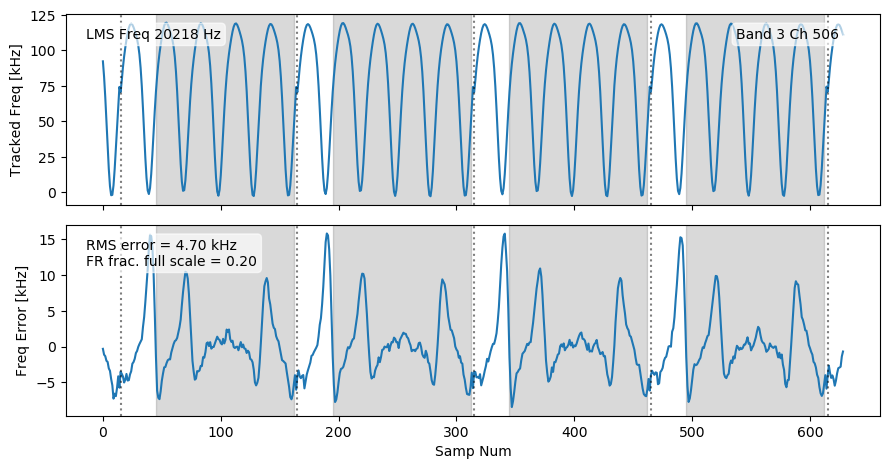

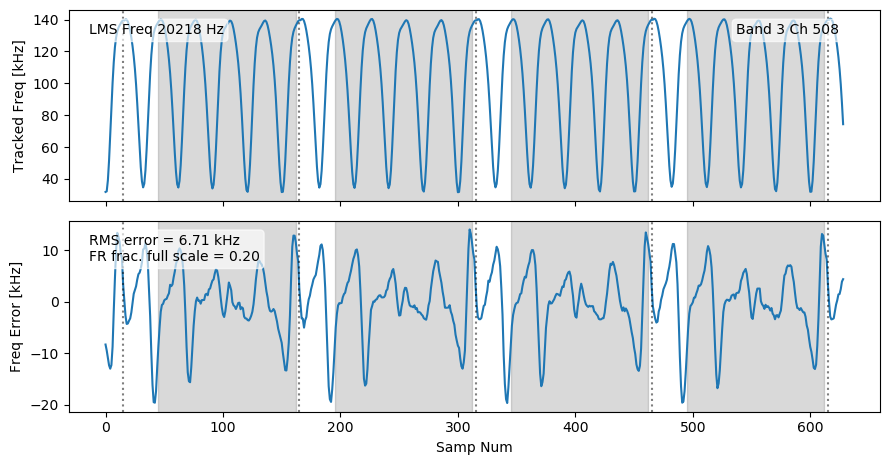

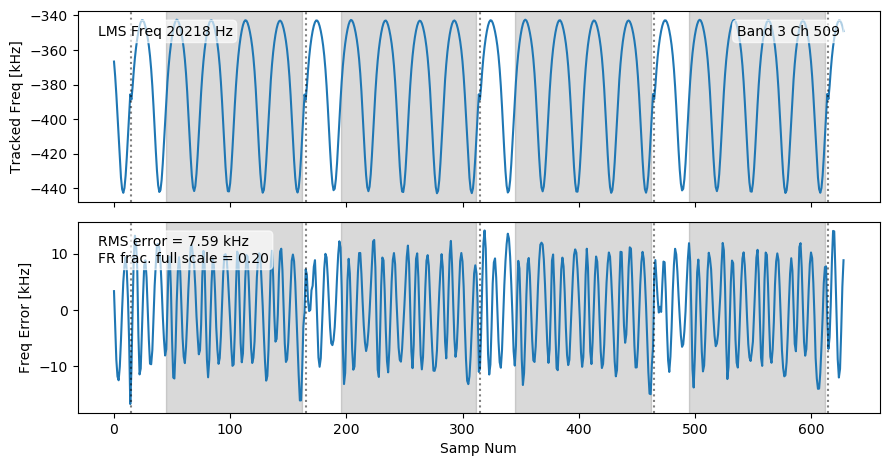

In [300]:

S.set_feedback_enable(band,1)
S.tracking_setup(band, channel = S.which_on(band), reset_rate_khz=4, make_plot=True, save_plot=True, show_plot=True, 
                  lms_freq_hz=None, n_phi0=5, meas_flux_ramp_amp=False, fraction_full_scale=0.195,feedback_gain=2048,lms_gain=0,
                  return_data=False, feedback_start_frac=0.2, feedback_end_frac=0.98,nsamp = 2**18, new_epics_root='smurf_server_s4')

That actually looks ok.

## Take noise data

We're mostly tracking ~200 resonators.  Let's let it rip with the RFSoC, just for kicks.

[ 2024-08-09 18:09:06 ]  Starting to take data.
[ 2024-08-09 18:09:06 ]  Input downsample factor is None. Using value already in pyrogue: 20
[ 2024-08-09 18:09:06 ]  Flux ramp is AC-coupled.
[ 2024-08-09 18:09:08 ]  caput smurf_server_s3:AMCc:SmurfProcessor:Unwrapper:reset 1
[ 2024-08-09 18:09:08 ]  caput smurf_server_s3:AMCc:SmurfProcessor:Filter:reset 1
[ 2024-08-09 18:09:08 ]  Writing to file : /data/smurf_data/20240809/1723162986/outputs/1723226949.dat
[ 2024-08-09 18:09:08 ]  /data/smurf_data/20240809/1723162986/outputs/1723226949_mask.txt
[ 2024-08-09 18:09:08 ]  Writing frequency mask.
[ 2024-08-09 18:09:08 ]  caput smurf_server_s3:AMCc:SmurfProcessor:FileWriter:Open 1
[ 2024-08-09 18:10:08 ]  caput smurf_server_s3:AMCc:SmurfProcessor:FileWriter:Close 1
[ 2024-08-09 18:10:08 ]  caput smurf_server_s3:AMCc:FpgaTopLevel:AppTop:AppCore:enableStreaming 0
[ 2024-08-09 18:10:08 ]  Waiting 0.15 seconds after...
[ 2024-08-09 18:10:08 ]  Done waiting.
[ 2024-08-09 18:10:08 ]  Done taking 

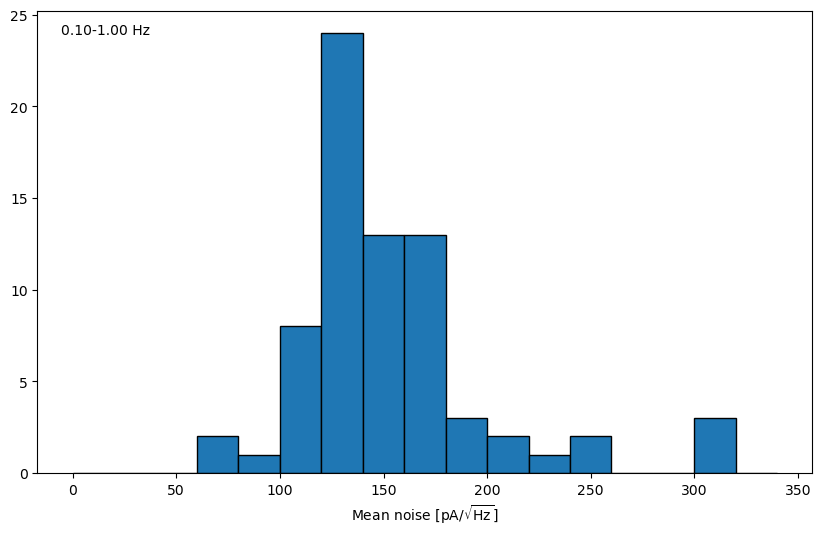

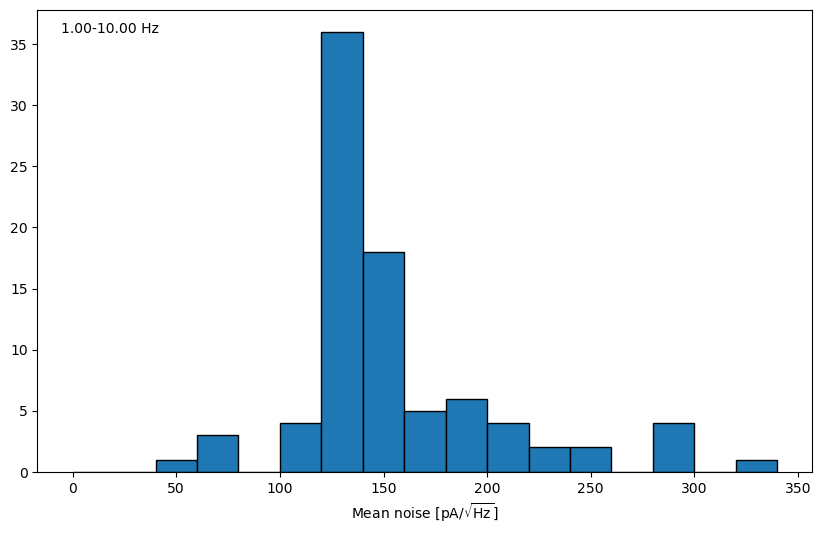

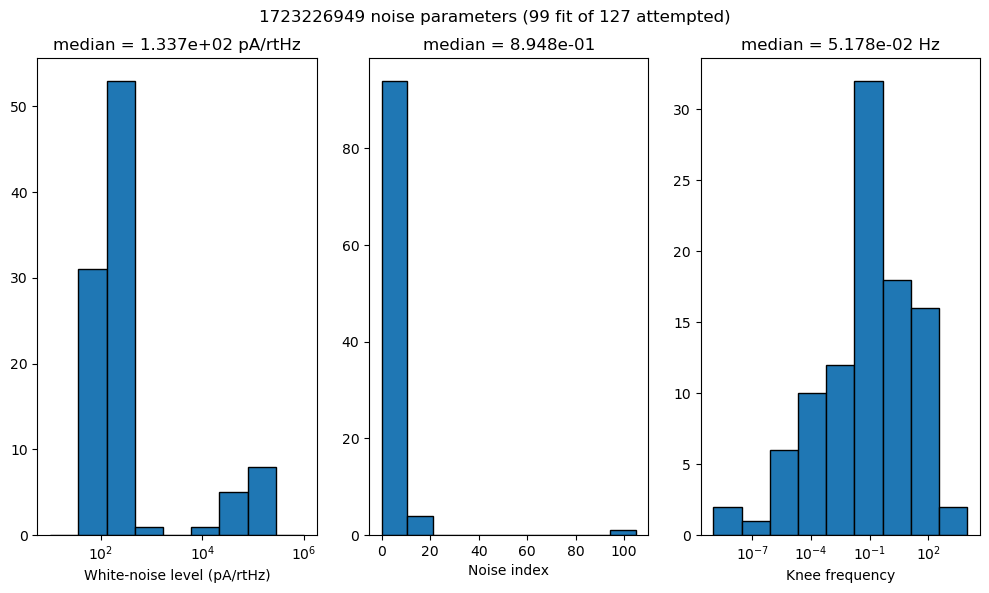

'/data/smurf_data/20240809/1723162986/outputs/1723226949.dat'

In [301]:
S.take_noise_psd(60,show_plot=True)

Here's a hack for looking at individual timestream plots; first one on SMB that's dark;

In [123]:
#Import library
from IPython.display import Image
# Load image from local storage
plt.ion()

Image(filename = "/data/smurf_data/20240808/1723154700/plots/1723162338_noise_timestream_b2_ch255.png", width = 600, height = 300)

FileNotFoundError: [Errno 2] No such file or directory: '/data/smurf_data/20240809/1723154700/plots/1723162338_noise_timestream_b2_ch255.png'